# Data Augmentation Workbook

Made a few methods and a start to adding extra features to the dataset to allow the model to train on more images than the ~200 we have. 

This uses the OpenCV Haar Cascade classifier to detect faces, then just basically pastes a PNG onto the image at that detection point. Currently saves output to a file for easy viewing and sharing.

Currently works pretty well on straight faces, needs work for looking to the side or at an angle

In [1]:
import cv2
from matplotlib import pyplot as plt
import os
import math

##### Basic Helper functions that probably can be optimized but work for now.

In [2]:
def showImage(img):
    plt.imshow(img)
    plt.show()

def showLotsOfImages(lImg, columns=5, saveName='outputImage.jpg', pFigsize=(15,15)):
    column_numbers = columns
    w = column_numbers
    h = math.ceil(len(lImg) / w)

    # create places for images
    fig, axs = plt.subplots(h, w, figsize=pFigsize)

    # remove axis for every image
    for row in axs:
        for ax in row:
            ax.axis('off')

    # display image
    for i, img in enumerate(lImg):
        # calculate position 
        col = i % column_numbers
        row = i // column_numbers

        # display image
        axs[row][col].imshow(img)

    # save in file - it has to be before `show()`
    plt.savefig(saveName)

    # display all 
    plt.show()


### Two functions for adding Sunglasses and a Hat to the image


In [3]:
def addSunglasses(img, faces):
    sunglasses = cv2.imread(os.getcwd() + '/assets/sunglasses.png', cv2.IMREAD_UNCHANGED)
    sImage = img.copy()
    for (x, y, w, h) in faces:
        # Resize sunglasses to fit the face width
        sW = w
        sH = h // 2
        resized_sunglasses = cv2.resize(sunglasses, (sW, sH))
        # Position the sunglasses on the face
        x_offset = x 
        y_offset = y + (h // 4)
        x_end = x_offset + resized_sunglasses.shape[1]
        y_end = y_offset + resized_sunglasses.shape[0]
        
        if x_offset >= 0 and y_offset >= 0 and x_end <= sImage.shape[1] and y_end <= sImage.shape[0]:
            # Add the sunglasses to the image
            alpha_s = resized_sunglasses[:, :, 3] / 255.0
            alpha_l = 1.0 - alpha_s
            for c in range(0, 3):
                sImage[y_offset:y_end, x_offset:x_end, c] = (alpha_s * resized_sunglasses[:, :, c] +
                alpha_l * sImage[y_offset:y_end, x_offset:x_end, c])
        else:
            print("Sunglasses position is outside image boundaries. Skipping...")
    return sImage

def addHat(img, faces):
    hat = cv2.imread(os.getcwd() + '/assets/cap.png', cv2.IMREAD_UNCHANGED)
    hImage = img.copy()
    for (x, y, w, h) in faces:
        # Resize hat to fit the face width
        sW = w
        sH = h
        resized_hat = cv2.resize(hat, (sW, sH))
        # Position the hat on top of the face
        x_offset = x - int(w * (1/8))
        y_offset = y - int(h * (2/3))
        x_end = x_offset + resized_hat.shape[1]
        y_end = y_offset + resized_hat.shape[0]
        # Add the hat to the image
        # Check if hat position is within image boundaries
        if x_offset >= 0 and y_offset >= 0 and x_end <= hImage.shape[1] and y_end <= hImage.shape[0]:
            alpha_s = resized_hat[:, :, 3] / 255.0
            alpha_l = 1.0 - alpha_s
            for c in range(0, 3):
                hImage[y_offset:y_end, x_offset:x_end, c] = (alpha_s * resized_hat[:, :, c] +
                    alpha_l * hImage[y_offset:y_end, x_offset:x_end, c])
        else:
            print("Hat position is outside image boundaries. Skipping...")

    return hImage


###### Here is a cell to loop through as many pictures as you would like, saves them, and displays them

How it is currently set up, it is easier to open the file and zoom in rather trying to see them in this notebook.

[ + ] Loading 100 images...
[ + ] Done loading 100 images...
[ + ] Plotting 100 images...


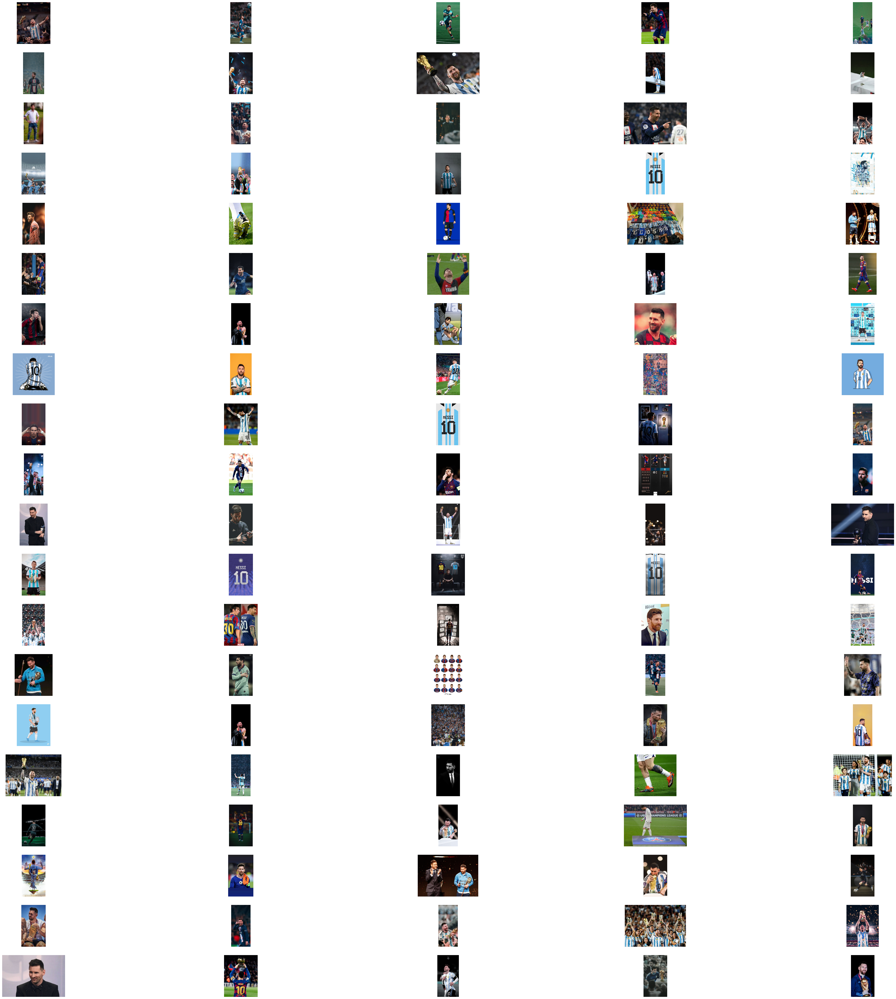

[ + ] Done Plotting 100 images...
[ + ] Adding sunglasses and hats to 100 images...


libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known inc

Hat position is outside image boundaries. Skipping...
Hat position is outside image boundaries. Skipping...
Hat position is outside image boundaries. Skipping...


libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known inc

[ + ] Done adding sunglasses and hats to 100 images...
[ + ] Plotting 100 images...


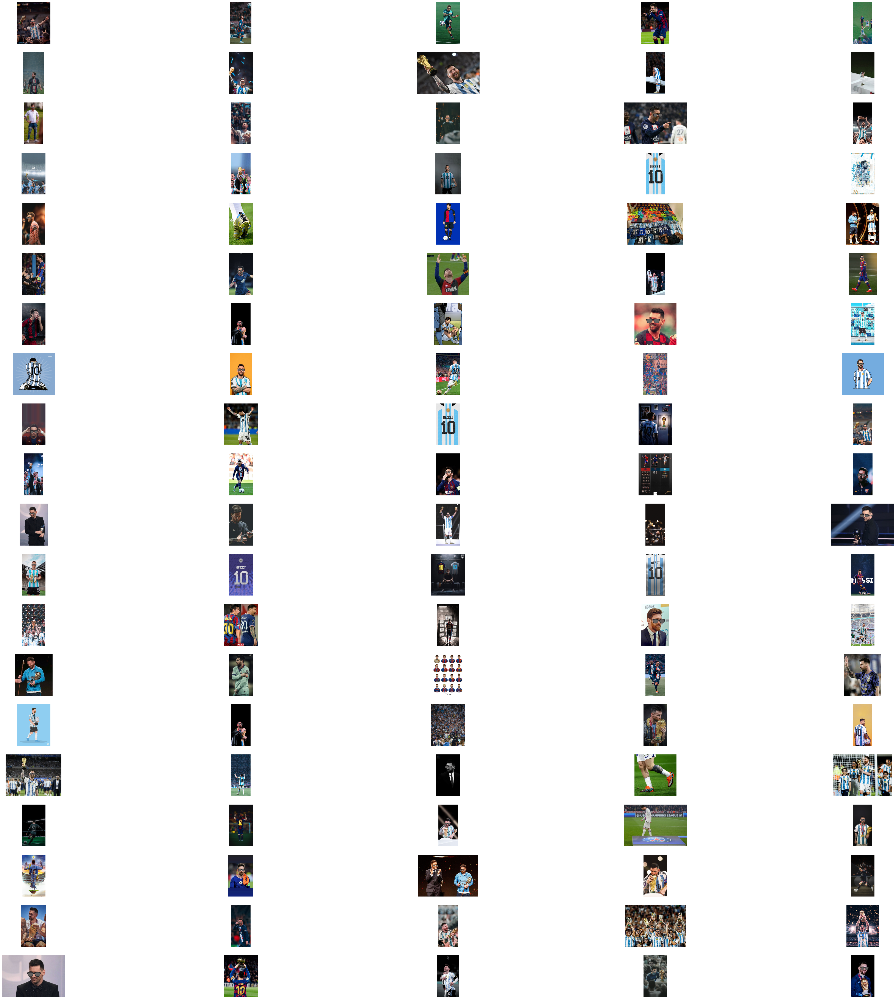

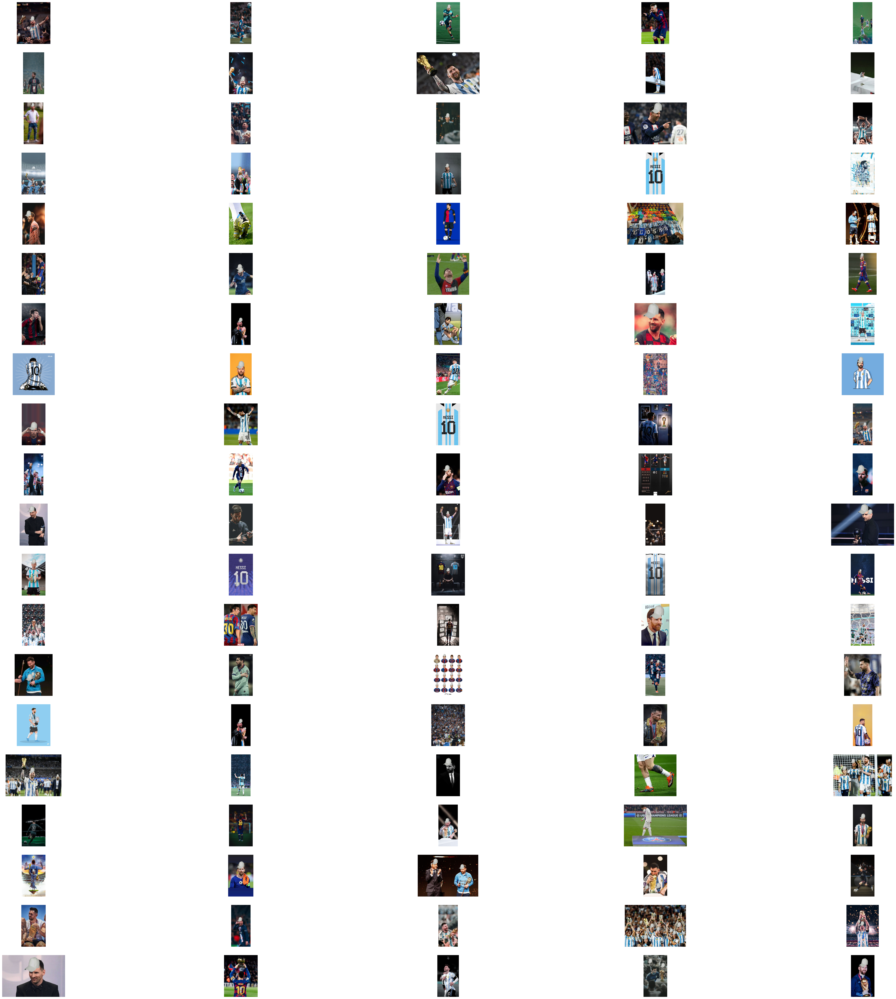

[ + ] Done Plotting 100 images...


In [7]:
how_many_pictures = 100
figure_size = (60,60)

from os import listdir
from os.path import isfile, join

def get_files(mypath):
    onlyfiles = [join(mypath, f) for f in listdir(mypath) if isfile(join(mypath, f))]
    return onlyfiles

# Get all files from Dataset
allFiles = get_files(os.getcwd() + '/assets/fbDataset/Messi/')

# Get just a few for testing
first100 = allFiles[:how_many_pictures]

# Load them all
print(f"[ + ] Loading {how_many_pictures} images...")
lImgs = [cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB) for path in first100]
print(f"[ + ] Done loading {how_many_pictures} images...")
print(f"[ + ] Plotting {how_many_pictures} images...")
showLotsOfImages(lImgs, pFigsize=figure_size)
print(f"[ + ] Done Plotting {how_many_pictures} images...")


# Add extra to them all
sLImgs = []
hLImgs = []
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
print(f"[ + ] Adding sunglasses and hats to {how_many_pictures} images...")
for img in lImgs:
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))
    sLImgs.append(addSunglasses(img, faces))
    hLImgs.append(addHat(img, faces))

print(f"[ + ] Done adding sunglasses and hats to {how_many_pictures} images...")
print(f"[ + ] Plotting {how_many_pictures} images...")
showLotsOfImages(sLImgs, saveName='outputSunglassesImg.jpg', pFigsize=figure_size)
showLotsOfImages(hLImgs, saveName='outputHatImg.jpg', pFigsize=figure_size)
print(f"[ + ] Done Plotting {how_many_pictures} images...")
    



## If you just want to mess around with a single picture or edit the algo:




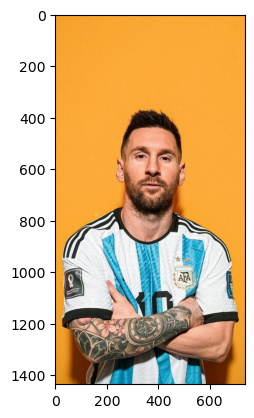

In [87]:
path = "/home/hice1/eleleux3/scratch/segment-and-replace/assets/fbDataset/Messi/052c4ec476594472bb32ae8c37a6ca38.jpg"
sunGlassesPath = "/home/hice1/eleleux3/scratch/segment-and-replace/assets/sunglasses.png"
hatPath = "/home/hice1/eleleux3/scratch/segment-and-replace/assets/cap.png"

image = cv2.imread(path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

showImage(image)

In [88]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

libpng warning: iCCP: known incorrect sRGB profile


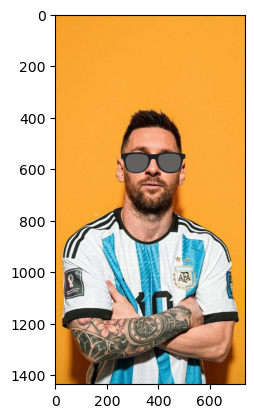

In [89]:
sunglasses = cv2.imread(sunGlassesPath, cv2.IMREAD_UNCHANGED)
sImage = image.copy()
for (x, y, w, h) in faces:
    # Resize sunglasses to fit the face width
    sW = w
    sH = h // 2
    resized_sunglasses = cv2.resize(sunglasses, (sW, sH))
    # Position the sunglasses on the face
    x_offset = x 
    y_offset = y + (h // 4)
    x_end = x_offset + resized_sunglasses.shape[1]
    y_end = y_offset + resized_sunglasses.shape[0]
    # Add the sunglasses to the image
    alpha_s = resized_sunglasses[:, :, 3] / 255.0
    alpha_l = 1.0 - alpha_s
    for c in range(0, 3):
        sImage[y_offset:y_end, x_offset:x_end, c] = (alpha_s * resized_sunglasses[:, :, c] +
        alpha_l * sImage[y_offset:y_end, x_offset:x_end, c])

showImage(sImage)

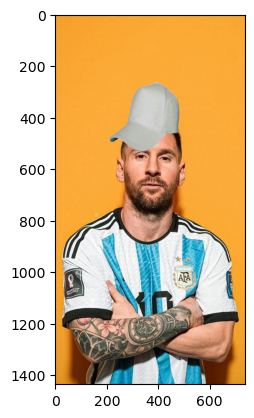

In [90]:
hat = cv2.imread(hatPath, cv2.IMREAD_UNCHANGED)
hImage = image.copy()
for (x, y, w, h) in faces:
    # Resize hat to fit the face width
    sW = w
    sH = h
    resized_hat = cv2.resize(hat, (sW, sH))
    # Position the hat on top of the face
    x_offset = x - int(w * (1/8))
    y_offset = y - int(h * (2/3))
    x_end = x_offset + resized_hat.shape[1]
    y_end = y_offset + resized_hat.shape[0]
    # Add the hat to the image
    alpha_s = resized_hat[:, :, 3] / 255.0
    alpha_l = 1.0 - alpha_s
    for c in range(0, 3):
        hImage[y_offset:y_end, x_offset:x_end, c] = (alpha_s * resized_hat[:, :, c] +
            alpha_l * hImage[y_offset:y_end, x_offset:x_end, c])

showImage(hImage)